In [1]:
#import libraries
import cv2
import numpy as np
import matplotlib.pyplot as plt
from skimage.metrics import mean_squared_error, peak_signal_noise_ratio
from skimage import filters
from skimage.data import camera
from skimage.util import compare_images
import skimage.io
from skimage import measure
from IPython.display import Image
import pandas as pd

C:\Users\kmcex\Anaconda3\lib\site-packages\skimage\io\manage_plugins.py:23: UserWarning: Your installed pillow version is < 7.1.0. Several security issues (CVE-2020-11538, CVE-2020-10379, CVE-2020-10994, CVE-2020-10177) have been fixed in pillow 7.1.0 or higher. We recommend to upgrade this library.
  from .collection import imread_collection_wrapper


# BASELINE (Image of Thunderhill Track from youtube video)

Link to video: https://www.youtube.com/watch?v=jLmtuveVzrs

(879, 1441)


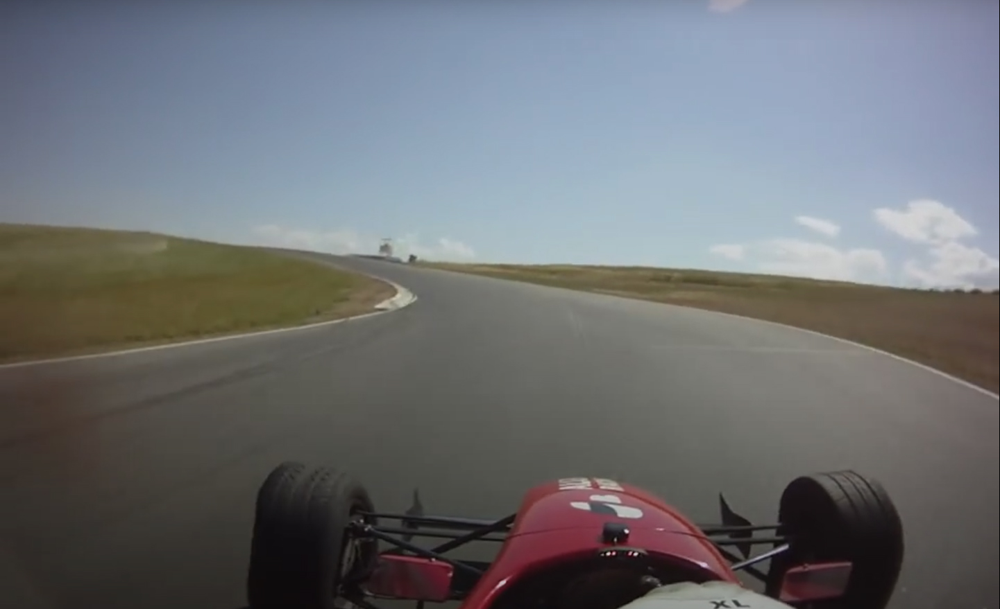

In [64]:
bs = cv2.imread('Baseline.jpg', 1)
bs = cv2.cvtColor(bs, cv2.COLOR_RGBA2BGR)
bs = cv2.cvtColor(bs, cv2.COLOR_RGBA2GRAY)
bs = cv2.GaussianBlur(bs, (5,5), 0)
print(bs.shape)
Image(filename='Baseline.jpg')

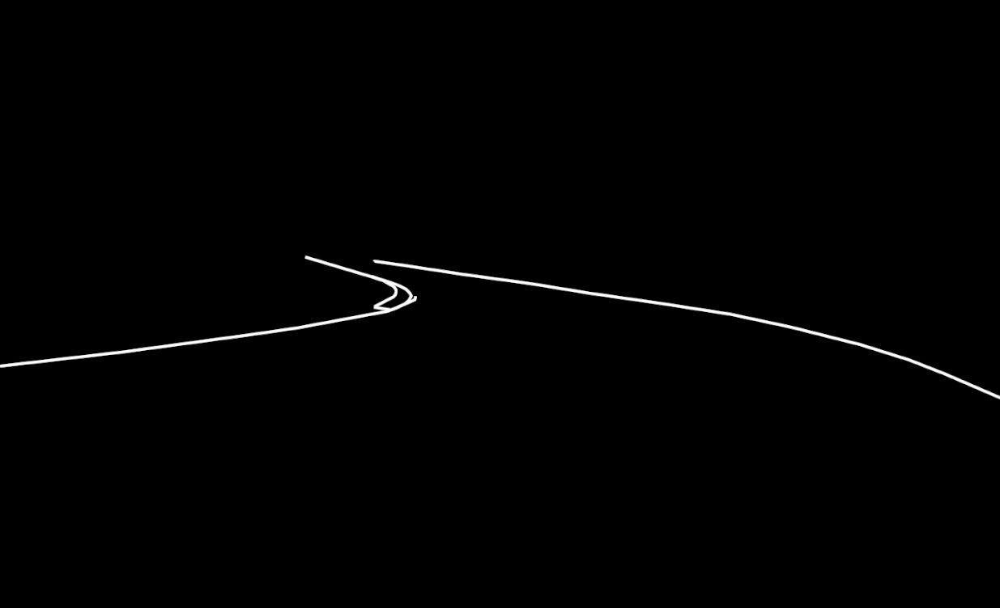

In [65]:
bs_gt = cv2.imread('Baseline_truth.jpg', 1)
bs_gt = cv2.cvtColor(bs_gt, cv2.COLOR_RGBA2BGR)
bs_gt = cv2.cvtColor(bs_gt, cv2.COLOR_RGBA2GRAY)

bs_gt = cv2.resize(bs_gt, (1441,879))
bs_gt = bs_gt / bs_gt.max()
bs_gt.shape
Image(filename='Baseline_truth.jpg')

In [66]:
# LoG
bs_lap = cv2.Laplacian(bs, cv2.CV_64F)
bs_lap = bs_lap/bs_lap.max()
print(bs_lap.shape)
# Sobel X
bs_sob = cv2.Sobel(bs, cv2.CV_64F, 1, 0, ksize=5)
bs_sob = bs_sob / bs_sob.max()
print(bs_sob.shape)
# Canny
bs_can = cv2.Canny(bs, 100, 200)
bs_can = bs_can / bs_can.max()
print(bs_can.shape)
# Prewitt
kernelx = np.array([[1,1,1],[0,0,0],[-1,-1,-1]])
bs_prew = cv2.filter2D(bs, -1, kernelx)
bs_prew = bs_prew / bs_prew.max()
print(bs_prew.shape)
# Roberts
bs_rob = filters.roberts(bs)
bs_rob = bs_rob / bs_rob.max()
print(bs_rob.shape)

(879, 1441)
(879, 1441)
(879, 1441)
(879, 1441)
(879, 1441)


In [68]:
bs_ssim_lap = skimage.metrics.structural_similarity(bs_gt, bs_lap)
bs_ssim_sob = skimage.metrics.structural_similarity(bs_gt, bs_sob)
bs_ssim_can = skimage.metrics.structural_similarity(bs_gt, bs_can)
bs_ssim_prew = skimage.metrics.structural_similarity(bs_gt, bs_prew)
bs_ssim_rob = skimage.metrics.structural_similarity(bs_gt, bs_rob)

print('SSIM of Baseline and ground truth')
print('Laplacian: ', bs_ssim_lap)
print('SobelX: ', bs_ssim_sob)
print('Canny: ', bs_ssim_can)
print('Prewitt: ', bs_ssim_prew)
print('Roberts: ', bs_ssim_rob)

SSIM of Baseline and ground truth
Laplacian:  0.8342577618328332
SobelX:  0.8946058264107136
Canny:  0.964759995295669
Prewitt:  0.8813161500263247
Roberts:  0.7963153418395347


# Reading in ZED Image (Straight Road)

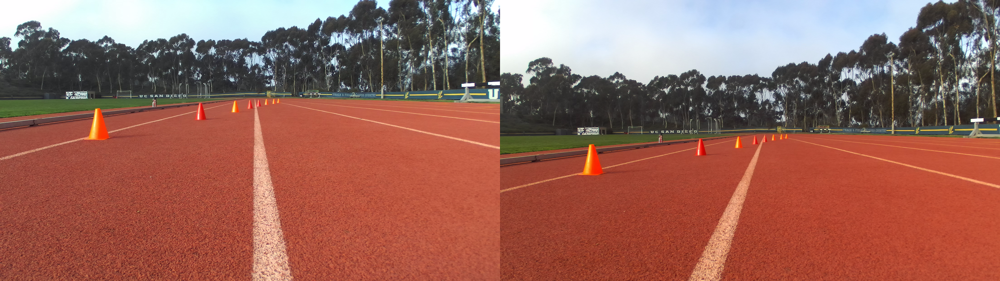

In [2]:
zed = cv2.imread('../test/testdata/ZED_1.png', 1)
zed = cv2.cvtColor(zed, cv2.COLOR_RGBA2BGR)
zed = cv2.cvtColor(zed, cv2.COLOR_RGBA2GRAY)
zed = cv2.GaussianBlur(zed, (5,5), 0)
zed.shape
Image(filename='../test/testdata/ZED_1.png')

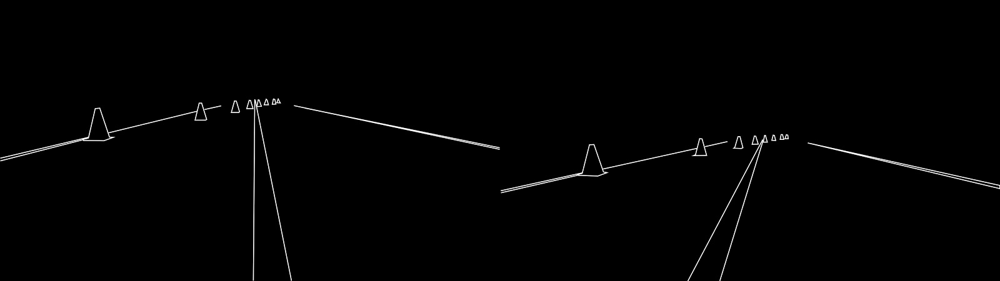

In [3]:
zed_gt = cv2.imread('../test/testdata/ZED_1_gt.jpg', 1)
zed_gt = cv2.cvtColor(zed_gt, cv2.COLOR_RGBA2BGR)
zed_gt = cv2.cvtColor(zed_gt, cv2.COLOR_RGBA2GRAY)
zed_gt = cv2.resize(zed_gt, (4416, 1242))
zed_gt = zed_gt / zed_gt.max()
zed_gt.shape
Image(filename='../test/testdata/ZED_1_gt.jpg')

# SSIMs for the 5 filters of ZED Image (Straight Road)

In [14]:
# LoG
z_lap = cv2.Laplacian(zed, cv2.CV_64F)
z_lap = z_lap/z_lap.max()
print(z_lap.shape)
# Sobel X
z_sob = cv2.Sobel(zed, cv2.CV_64F, 1, 0, ksize=5)
z_sob = z_sob / z_sob.max()
print(z_sob.shape)
# Canny
z_can = cv2.Canny(zed, 100, 200)
z_can = z_can / z_can.max()
print(z_can.shape)
# Prewitt
kernelx = np.array([[1,1,1],[0,0,0],[-1,-1,-1]])
z_prew = cv2.filter2D(zed, -1, kernelx)
z_prew = z_prew / z_prew.max()
print(z_prew.shape)
# Roberts
z_rob = filters.roberts(zed)
z_rob = z_rob / z_rob.max()
print(z_rob.shape)

(1242, 4416)
(1242, 4416)
(1242, 4416)
(1242, 4416)
(1242, 4416)


In [15]:
z_ssim_lap = skimage.metrics.structural_similarity(zed_gt, z_lap)
z_ssim_sob = skimage.metrics.structural_similarity(zed_gt, z_sob)
z_ssim_can = skimage.metrics.structural_similarity(zed_gt, z_can)
z_ssim_prew = skimage.metrics.structural_similarity(zed_gt, z_prew)
z_ssim_rob = skimage.metrics.structural_similarity(zed_gt, z_rob)

print('SSIM of ZED (striaght road) and ground truth')
print('Laplacian: ', z_ssim_lap)
print('SobelX: ', z_ssim_sob)
print('Canny: ', z_ssim_can)
print('Prewitt: ', z_ssim_prew)
print('Roberts: ', z_ssim_rob)

SSIM of ZED (striaght road) and ground truth
Laplacian:  0.6483959166703511
SobelX:  0.6513728944387894
Canny:  0.8450896902682067
Prewitt:  0.5505849481421549
Roberts:  0.4116109333403225


# Reading in Intel RealSense Image (Straight Road)

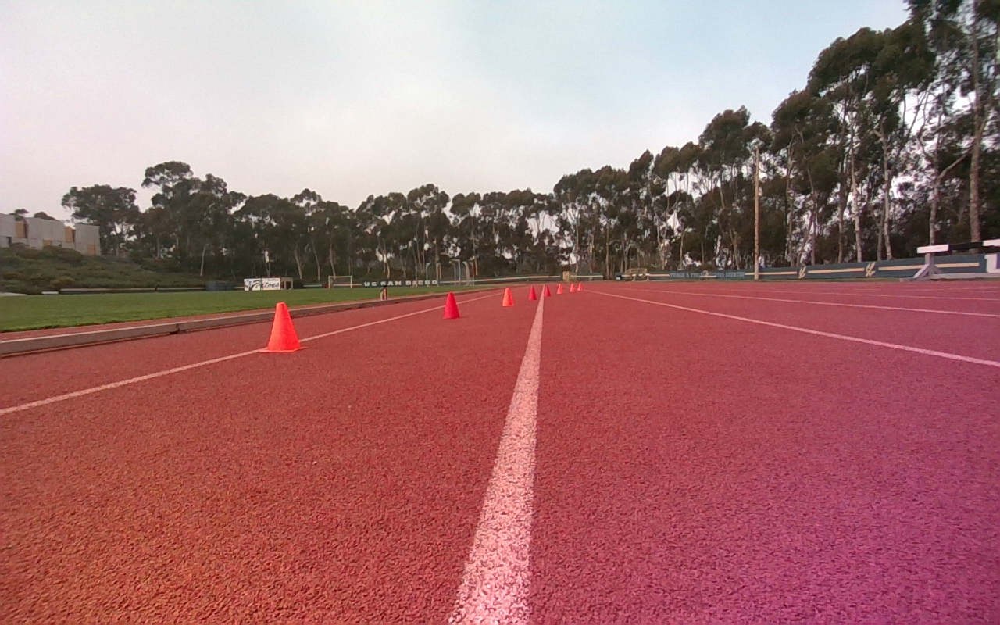

In [5]:
intel = cv2.imread('../test/testdata/IntelRS_1.png', 1)
intel = cv2.cvtColor(intel, cv2.COLOR_RGBA2BGR)
intel = cv2.cvtColor(intel, cv2.COLOR_RGBA2GRAY)
intel = cv2.GaussianBlur(intel, (5,5), 0)
intel.shape
Image(filename='../test/testdata/IntelRS_1.png')

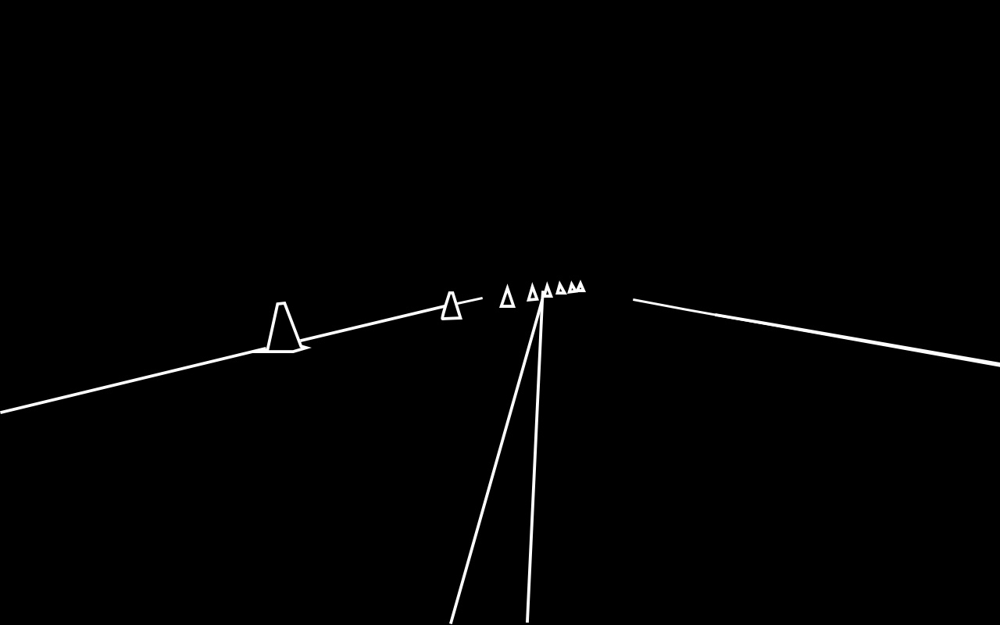

In [6]:
intel_gt = cv2.imread('../test/testdata/IntelRS_1_gt.jpg', 1)
intel_gt = cv2.cvtColor(intel_gt, cv2.COLOR_RGBA2BGR)
intel_gt = cv2.cvtColor(intel_gt, cv2.COLOR_RGBA2GRAY)

intel_gt = cv2.resize(intel_gt, (1280,800))
intel_gt = intel_gt / intel_gt.max()
intel_gt.shape
Image(filename='../test/testdata/IntelRS_1_gt.jpg')

# SSIMs for the 5 filters of Intel RealSense Image (Straight Road)

In [22]:
# LoG
i_lap = cv2.Laplacian(intel, cv2.CV_64F)
i_lap = i_lap/i_lap.max()
print(i_lap.shape)
# Sobel X
i_sob = cv2.Sobel(intel, cv2.CV_64F, 1, 0, ksize=5)
i_sob = i_sob / i_sob.max()
print(i_sob.shape)
# Canny
i_can = cv2.Canny(intel, 100, 200)
i_can = i_can / i_can.max()
print(i_can.shape)
# Prewitt
kernelx = np.array([[1,1,1],[0,0,0],[-1,-1,-1]])
i_prew = cv2.filter2D(intel, -1, kernelx)
i_prew = i_prew / i_prew.max()
print(i_prew.shape)
# Roberts
i_rob = filters.roberts(intel)
i_rob = i_rob / i_rob.max()
print(i_rob.shape)

(800, 1280)
(800, 1280)
(800, 1280)
(800, 1280)
(800, 1280)


In [23]:
i_ssim_lap = skimage.metrics.structural_similarity(intel_gt, i_lap)
i_ssim_sob = skimage.metrics.structural_similarity(intel_gt, i_sob)
i_ssim_can = skimage.metrics.structural_similarity(intel_gt, i_can)
i_ssim_prew = skimage.metrics.structural_similarity(intel_gt, i_prew)
i_ssim_rob = skimage.metrics.structural_similarity(intel_gt, i_rob)

print('SSIM of Intel and ground truth')
print('Laplacian: ', i_ssim_lap)
print('SobelX: ', i_ssim_sob)
print('Canny: ', i_ssim_can)
print('Prewitt: ', i_ssim_prew)
print('Roberts: ', i_ssim_rob)

SSIM of Intel and ground truth
Laplacian:  0.38894825112837467
SobelX:  0.5836190743774183
Canny:  0.8220421084717837
Prewitt:  0.4890396462158374
Roberts:  0.30532515781258895


# Comparion of SSIMs Between the Two Cameras for Striaght Roads

In [24]:
pd.DataFrame(
    index=['Laplacian', 'SobelX', 'Canny', 'Prewitt', 'Roberts'],
    columns=['ZED', 'Intel RealSense D455'],
    data=[
        [z_ssim_lap, i_ssim_lap], [z_ssim_sob, i_ssim_sob], 
        [z_ssim_can, i_ssim_can], [z_ssim_prew, i_ssim_prew], 
        [z_ssim_rob, i_ssim_rob]
    ]
)

,ZED,Intel RealSense D455
Laplacian,0.648396,0.388948
SobelX,0.651373,0.583619
Canny,0.845090,0.822042
Prewitt,0.550585,0.489040
Roberts,0.411611,0.305325


# Reading in ZED Image (Curved Road)¶

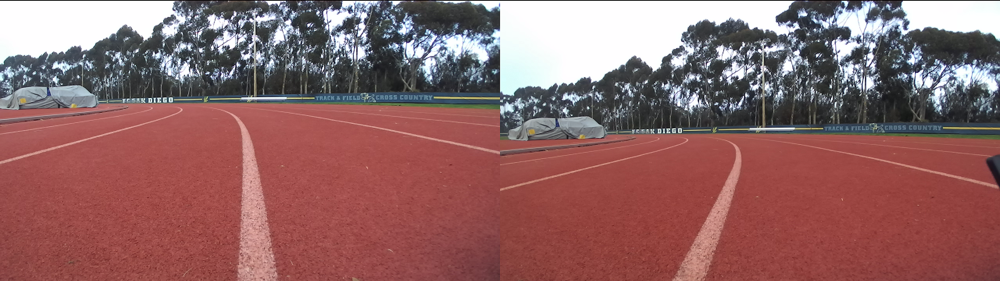

In [7]:
zed2 = cv2.imread('../test/testdata/ZED_2.png', 1)
zed2 = cv2.cvtColor(zed2, cv2.COLOR_RGBA2BGR)
zed2 = cv2.cvtColor(zed2, cv2.COLOR_RGBA2GRAY)
zed2 = cv2.GaussianBlur(zed2, (5,5), 0)
zed2.shape
Image(filename='../test/testdata/ZED_2.png')

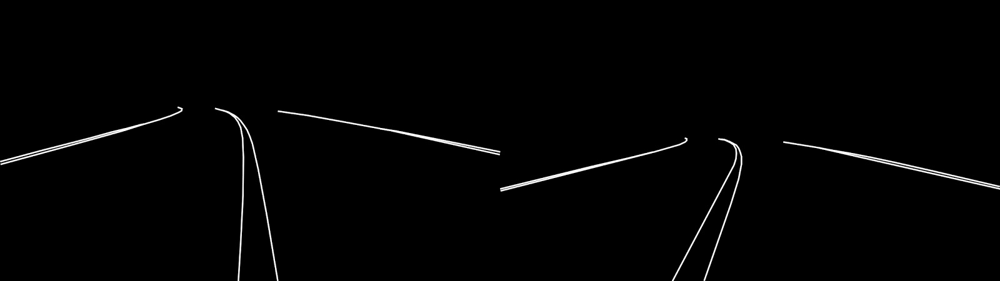

In [8]:
zed2_gt = cv2.imread('../test/testdata/ZED_2_gt.jpg', 1)
zed2_gt = cv2.cvtColor(zed2_gt, cv2.COLOR_RGBA2BGR)
zed2_gt = cv2.cvtColor(zed2_gt, cv2.COLOR_RGBA2GRAY)

zed2_gt = cv2.resize(zed2_gt, (2560,720))
zed2_gt = zed2_gt / zed2_gt.max()
zed2_gt.shape
Image(filename='../test/testdata/ZED_2_gt.jpg')

# SSIMs for the 5 filters of ZED Image (Curved Road)

In [32]:
# LoG
z_lap = cv2.Laplacian(zed2, cv2.CV_64F)
z_lap = z_lap/z_lap.max()
print(z_lap.shape)
# Sobel X
z_sob = cv2.Sobel(zed2, cv2.CV_64F, 1, 0, ksize=5)
z_sob = z_sob / z_sob.max()
print(z_sob.shape)
# Canny
z_can = cv2.Canny(zed2, 100, 200)
z_can = z_can / z_can.max()
print(z_can.shape)
# Prewitt
kernelx = np.array([[1,1,1],[0,0,0],[-1,-1,-1]])
z_prew = cv2.filter2D(zed2, -1, kernelx)
z_prew = z_prew / z_prew.max()
print(z_prew.shape)
# Roberts
z_rob = filters.roberts(zed2)
z_rob = z_rob / z_rob.max()
print(z_rob.shape)

(720, 2560)
(720, 2560)
(720, 2560)
(720, 2560)
(720, 2560)


In [33]:
z_ssim_lap = skimage.metrics.structural_similarity(zed2_gt, z_lap)
z_ssim_sob = skimage.metrics.structural_similarity(zed2_gt, z_sob)
z_ssim_can = skimage.metrics.structural_similarity(zed2_gt, z_can)
z_ssim_prew = skimage.metrics.structural_similarity(zed2_gt, z_prew)
z_ssim_rob = skimage.metrics.structural_similarity(zed2_gt, z_rob)

print('SSIM of ZED (striaght road) and ground truth')
print('Laplacian: ', z_ssim_lap)
print('SobelX: ', z_ssim_sob)
print('Canny: ', z_ssim_can)
print('Prewitt: ', z_ssim_prew)
print('Roberts: ', z_ssim_rob)

SSIM of ZED (striaght road) and ground truth
Laplacian:  0.6122382025017931
SobelX:  0.6441822107769077
Canny:  0.7611880368302012
Prewitt:  0.5564171200662168
Roberts:  0.44686829772094316


# Reading In Intel RealSense Image (Curved Road)

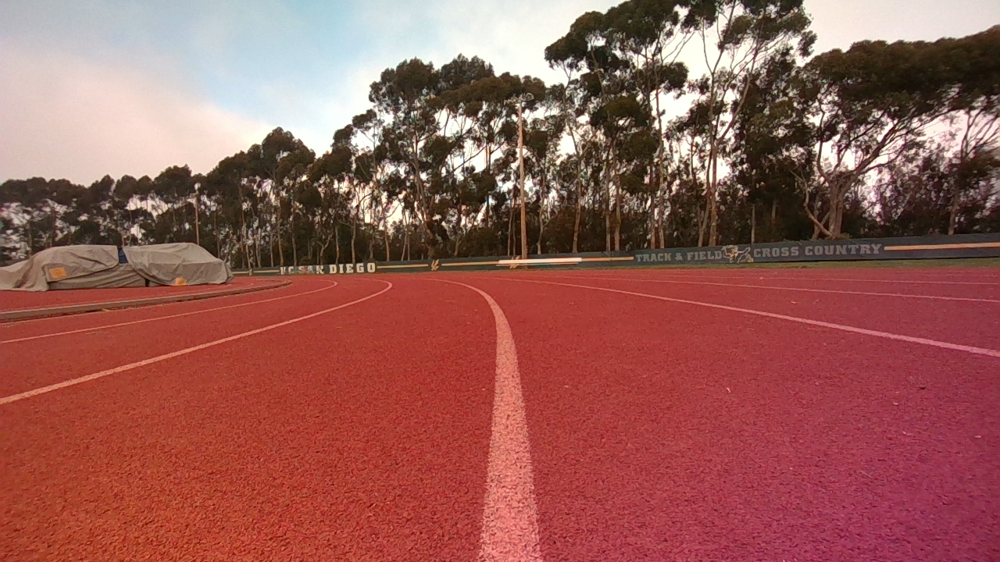

In [10]:
intel2 = cv2.imread('../test/testdata/IntelRS_2.png', 1)
intel2 = cv2.cvtColor(intel2, cv2.COLOR_RGBA2BGR)
intel2 = cv2.cvtColor(intel2, cv2.COLOR_RGBA2GRAY)
intel2 = cv2.GaussianBlur(intel2, (5,5), 0)
intel2.shape
Image(filename='../test/testdata/IntelRS_2.png')

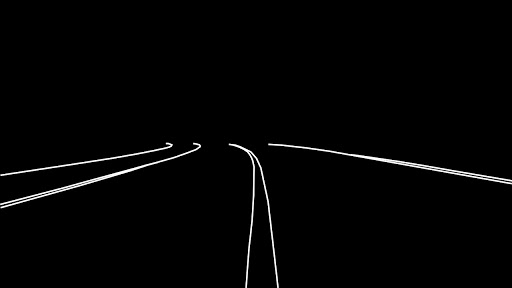

In [11]:
intel2_gt = cv2.imread('../test/testdata/IntelRS_2_gt.jpg', 1)
intel2_gt = cv2.cvtColor(intel2_gt, cv2.COLOR_RGBA2BGR)
intel2_gt = cv2.cvtColor(intel2_gt, cv2.COLOR_RGBA2GRAY)

intel2_gt = cv2.resize(intel2_gt, (1280,720))
intel2_gt = intel2_gt / intel2_gt.max()
intel2_gt.shape
Image(filename='../test/testdata/IntelRS_2_gt.jpg')

# SSIMs for the 5 filters of Intel RealSense Image (Curved Road)

In [39]:
# LoG
i_lap = cv2.Laplacian(intel2, cv2.CV_64F)
i_lap = i_lap/i_lap.max()
print(i_lap.shape)
# Sobel X
i_sob = cv2.Sobel(intel2, cv2.CV_64F, 1, 0, ksize=5)
i_sob = i_sob / i_sob.max()
print(i_sob.shape)
# Canny
i_can = cv2.Canny(intel2, 100, 200)
i_can = i_can / i_can.max()
print(i_can.shape)
# Prewitt
kernelx = np.array([[1,1,1],[0,0,0],[-1,-1,-1]])
i_prew = cv2.filter2D(intel2, -1, kernelx)
i_prew = i_prew / i_prew.max()
print(i_prew.shape)
# Roberts
i_rob = filters.roberts(intel2)
i_rob = i_rob / i_rob.max()
print(i_rob.shape)

(720, 1280)
(720, 1280)
(720, 1280)
(720, 1280)
(720, 1280)


In [40]:
i_ssim_lap = skimage.metrics.structural_similarity(intel2_gt, i_lap)
i_ssim_sob = skimage.metrics.structural_similarity(intel2_gt, i_sob)
i_ssim_can = skimage.metrics.structural_similarity(intel2_gt, i_can)
i_ssim_prew = skimage.metrics.structural_similarity(intel2_gt, i_prew)
i_ssim_rob = skimage.metrics.structural_similarity(intel2_gt, i_rob)

print('SSIM of Intel and ground truth')
print('Laplacian: ', i_ssim_lap)
print('SobelX: ', i_ssim_sob)
print('Canny: ', i_ssim_can)
print('Prewitt: ', i_ssim_prew)
print('Roberts: ', i_ssim_rob)

SSIM of Intel and ground truth
Laplacian:  0.41576370623988623
SobelX:  0.5469085789739622
Canny:  0.7492365747405312
Prewitt:  0.45467326819815274
Roberts:  0.2646902490682998


# Comparion of SSIMs Between the Two Cameras for Curved Roads

In [41]:
pd.DataFrame(
    index=['Laplacian', 'SobelX', 'Canny', 'Prewitt', 'Roberts'],
    columns=['ZED', 'Intel RealSense D455'],
    data=[
        [z_ssim_lap, i_ssim_lap], [z_ssim_sob, i_ssim_sob], 
        [z_ssim_can, i_ssim_can], [z_ssim_prew, i_ssim_prew], 
        [z_ssim_rob, i_ssim_rob]
    ]
)

,ZED,Intel RealSense D455
Laplacian,0.612238,0.415764
SobelX,0.644182,0.546909
Canny,0.761188,0.749237
Prewitt,0.556417,0.454673
Roberts,0.446868,0.264690
